<a href="https://colab.research.google.com/github/rezamohamadlo/Object_Tracking_wih_OpenCV/blob/main/Object_tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import necessary modules

# The 'os' module provides a way of using operating system-dependent functionality like reading or writing to the file system.
import os

# The 'sys' module provides access to some variables used or maintained by the interpreter and to functions that interact with the interpreter.
import sys

# The 'cv2' module is part of OpenCV, a library for computer vision tasks, including image and video processing.
import cv2

# The 'numpy' library is used for numerical computations in Python, particularly for working with arrays and matrices.
import numpy as np

# The 'matplotlib.pyplot' module is used for creating static, animated, and interactive visualizations in Python.
import matplotlib.pyplot as plt

# The 'Video' class from IPython.display is used to display video files in notebooks.
from IPython.display import Video

# The 'zipfile' module allows for reading and writing ZIP files, which can be useful for handling compressed data.
from zipfile import ZipFile

# The 'urlretrieve' function from 'urllib.request' is used to download files from the internet.
from urllib.request import urlretrieve

# The 'HTML' class from IPython.display is used to render HTML content in notebooks.
from IPython.display import HTML

# The 'FuncAnimation' class from 'matplotlib.animation' is used to create animations in matplotlib.
from matplotlib.animation import FuncAnimation


# The 'b64encode' function from 'base64' is used to encode binary data to base64 format, which is useful for embedding images or files in HTML.
from base64 import b64encode

# This magic command enables inline plotting in Jupyter notebooks, allowing plots to be displayed directly below the code cells.
%matplotlib inline

##  <font style="color:black">Download Assets</font>

In [2]:
def download_and_unzip(url, save_path):
    """
    Downloads a ZIP file from the specified URL and extracts its contents
    to the specified save path.

    Parameters:
    url (str): The URL of the ZIP file to download.
    save_path (str): The path where the downloaded ZIP file will be saved.
    """

    print(f"Downloading and extracting assets....", end="")

    # Downloading the ZIP file from the specified URL using the urlretrieve function.
    urlretrieve(url, save_path)

    try:
        # Attempt to extract the contents of the downloaded ZIP file.
        with ZipFile(save_path) as z:
            # Extract all contents of the ZIP file to the directory where the ZIP file is saved.
            z.extractall(os.path.split(save_path)[0])

        print("Done")  # Indicate that the extraction was successful.

    except Exception as e:
        # Handle any exceptions that occur during the extraction process.
        print("\nInvalid file.", e)  # Print an error message if the file is invalid or extraction fails.


In [3]:
URL = r"https://www.dropbox.com/s/ld535c8e0vueq6x/opencv_bootcamp_assets_NB11.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "opencv_bootcamp_assets_NB11.zip")

# Check if the assets ZIP file already exists
if not os.path.exists(asset_zip_path):
    # If the file doesn't exist, call the download_and_unzip function to download and extract it
    download_and_unzip(URL, asset_zip_path)


# Tracker Class in OpenCV

1. BOOSTING
2. MIL
3. KCF
4. CRST
5. TLD
 * Tends to recover from occulusions
6. MEDIANFLOW
 * Good for predictable slow motion
7. GOTURN
 * Deep Learning based
 * Most Accurate
8. MOSSE
 * Fastest

In [4]:
#this is the video that we are going to deploy objet tracking
Video('/content/race_car.mp4', embed=True, width=1024, height=640)

In [5]:
# Define the name of the input video file
video_input_file_name = "race_car.mp4"

def drawRectangle(frame, bbox):
    """
    Draws a rectangle on the given frame.

    Parameters:
    frame (numpy.ndarray): The image frame on which to draw the rectangle.
    bbox (tuple): A tuple containing the bounding box coordinates (x, y, width, height).
                  - x: The x-coordinate of the top-left corner of the rectangle.
                  - y: The y-coordinate of the top-left corner of the rectangle.
                  - width: The width of the rectangle.
                  - height: The height of the rectangle.
    """
    # Calculate the bottom-right corner of the rectangle
    p1 = (int(bbox[0]), int(bbox[1]))  # Top-left corner
    p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))  # Bottom-right corner

    # Draw the rectangle on the frame using OpenCV
    cv2.rectangle(frame, p1, p2, (255, 0, 0), 2, 1)  # Blue rectangle with thickness 2

def displayRectangle(frame, bbox):
    """
    Displays the frame with a rectangle drawn around the specified bounding box.

    Parameters:
    frame (numpy.ndarray): The image frame to display.
    bbox (tuple): A tuple containing the bounding box coordinates (x, y, width, height).
    """
    plt.figure(figsize=(20, 10))  # Set the figure size for display
    frameCopy = frame.copy()  # Create a copy of the frame to avoid modifying the original
    drawRectangle(frameCopy, bbox)  # Draw the rectangle on the copied frame
    frameCopy = cv2.cvtColor(frameCopy, cv2.COLOR_RGB2BGR)  # Convert color from RGB to BGR for display
    plt.imshow(frameCopy)  # Display the frame with the rectangle
    plt.axis("off")  # Turn off axis labels for better visualization

def drawText(frame, txt, location, color=(50, 170, 50)):
    """
    Draws text on the given frame at the specified location.

    Parameters:
    frame (numpy.ndarray): The image frame on which to draw the text.
    txt (str): The text string to be drawn.
    location (tuple): The (x, y) coordinates for the bottom-left corner of the text.
    color (tuple): The color of the text in BGR format (default is a shade of green).
    """
    # Put the text on the frame using OpenCV
    cv2.putText(frame, txt, location, cv2.FONT_HERSHEY_SIMPLEX, 1, color, 3)  # Draw text with specified parameters


# Create the Tracker instance

In [6]:
# Define a list of available tracker types
tracker_types = [
    "BOOSTING",      # Boosting-based tracker
    "MIL",           # Multiple Instance Learning tracker
    "KCF",           # Kernelized Correlation Filters tracker
    "CSRT",          # Discriminative Correlation Filter with Channel and Spatial Reliability tracker
    "TLD",           # Tracking-Learning-Detection tracker
    "MEDIANFLOW",    # MedianFlow tracker
    "GOTURN",        # Generic Object Tracking Using Regression Networks tracker
    "MOSSE",         # Minimum Output Sum of Squared Error tracker
]

# Change the index to select a different tracker type
tracker_type = tracker_types[6]  # Selecting the GOTURN tracker

# Initialize the tracker based on the selected tracker type
if tracker_type == "BOOSTING":
    tracker = cv2.legacy.TrackerBoosting.create()  # Create a Boosting tracker
elif tracker_type == "MIL":
    tracker = cv2.legacy.TrackerMIL.create()  # Create a MIL tracker
elif tracker_type == "KCF":
    tracker = cv2.TrackerKCF.create()  # Create a KCF tracker
elif tracker_type == "CSRT":
    tracker = cv2.TrackerCSRT.create()  # Create a CSRT tracker
elif tracker_type == "TLD":
    tracker = cv2.legacy.TrackerTLD.create()  # Create a TLD tracker
elif tracker_type == "MEDIANFLOW":
    tracker = cv2.legacy.TrackerMedianFlow.create()  # Create a MedianFlow tracker
elif tracker_type == "GOTURN":
    tracker = cv2.TrackerGOTURN.create()  # Create a GOTURN tracker
else:
    tracker = cv2.legacy.TrackerMOSSE.create()  # Create a MOSSE tracker as a default option


# Read input video & Setup output Video

In [7]:
# Open the video file for reading
video = cv2.VideoCapture(video_input_file_name)

# Read the first frame from the video
ok, frame = video.read()

# Check if the video was opened successfully
if not video.isOpened():
    print("Could not open video")  # Print an error message if the video cannot be opened
    sys.exit()  # Exit the program if the video cannot be opened
else:
    # Get the width and height of the video frames
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))  # Get the width of the video
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))  # Get the height of the video

# Define the output video file name based on the tracker type
video_output_file_name = "race_car-" + tracker_type + ".mp4"

# Create a VideoWriter object to write the output video
video_out = cv2.VideoWriter(video_output_file_name, cv2.VideoWriter_fourcc(*"XVID"), 10, (width, height))
# - video_output_file_name: Name of the output video file
# - cv2.VideoWriter_fourcc(*"XVID"): Codec to use for the output video (XVID in this case)
# - 10: Frames per second (fps) for the output video
# - (width, height): Size of the video frames

# Display the output video file name
video_output_file_name


'race_car-GOTURN.mp4'

# Define Bounding Box

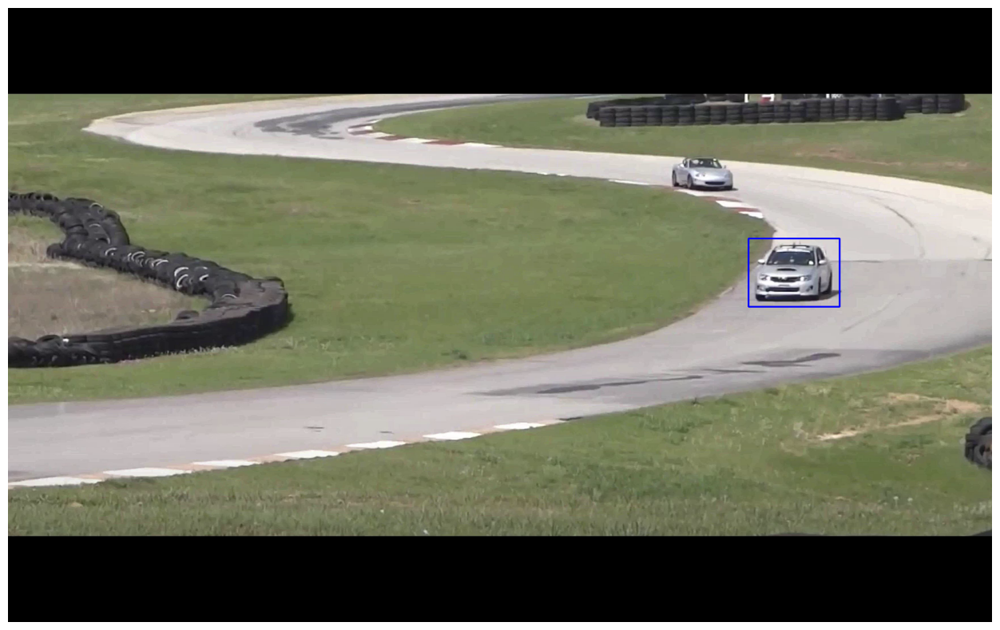

In [8]:
# Define a bounding box
bbox = (1300, 405, 160, 120)
# bbox = cv2.selectROI(frame, False)
# print(bbox)
displayRectangle(frame, bbox)

# Intilialize Tracker

1. One frame
2. A bounding box


In [9]:
# Initialize tracker with first frame and bounding box
ok = tracker.init(frame, bbox)

# Read frame and Track Object

In [10]:
# Start an infinite loop to process video frames
while True:
    # Read the next frame from the video
    ok, frame = video.read()

    # Break the loop if no frame is returned (end of video)
    if not ok:
        break

    # Start a timer to measure the processing time
    timer = cv2.getTickCount()

    # Update the tracker with the current frame
    ok, bbox = tracker.update(frame)

    # Calculate Frames per Second (FPS)
    fps = cv2.getTickFrequency() / (cv2.getTickCount() - timer)  # Calculate FPS based on the time taken to process the frame

    # Draw the bounding box around the tracked object
    if ok:
        drawRectangle(frame, bbox)  # If tracking is successful, draw the bounding box
    else:
        # If tracking fails, display a failure message
        drawText(frame, "Tracking failure detected", (80, 140), (0, 0, 255))  # Red text for failure message

    # Display tracking information on the frame
    drawText(frame, tracker_type + " Tracker", (80, 60))  # Display the type of tracker being used
    drawText(frame, "FPS : " + str(int(fps)), (80, 100))  # Display the calculated FPS

    # Write the processed frame to the output video
    video_out.write(frame)

# Release the video capture and writer objects after processing is complete
video.release()  # Release the video capture object
video_out.release()  # Release the video writer object


In [11]:
# Installing ffmpeg
!apt-get -qq install ffmpeg

# Change video encoding of mp4 file from XVID to h264
!ffmpeg -y -i {video_output_file_name} -c:v libx264 $"race_car_track_x264.mp4"  -hide_banner -loglevel error

Render MP4 Video

In [12]:
# Open the video file in binary read mode
mp4 = open("/content/race_car_track_x264.mp4", "rb").read()

# Encode the video file to base64 format
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

# Create an HTML video element to display the video
HTML(f"""<video width=1024 controls>
             <source src="{data_url}" type="video/mp4">
         </video>""")
